**images:**  `.//CenterNet//data//coco//images`
 
**results:** `//CenterNet//exp//multi_pose//default//result_poseval.json`

In [1]:
import json
data_pred = json.load(open('.//CenterNet//exp//multi_pose//default//result_poseval.json')) ## PRp
#data_gt = json.load(open('1.json')) ## GTp
data_pred = data_pred['annolist']
#data_gt = data_gt['annolist']

In [2]:
data_gt = json.load(open('1.json')) ## GTp
data_gt = data_gt['annolist']

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cbook as cbook
#всем кисям привет!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!мурка...

In [4]:
import eval_helpers as eh
ptg = eh.assignGTmulti(data_gt, data_pred, 0.5)

In [5]:
edges = [[0,1], [1,2], [2,6], [7,12], [12,11], [11,10], [5,4], [4,3], [3,6], [7,13], [13,14], [14,15], [6,7], [7,8], [8,9]]


In [6]:
import skimage.io
import cv2

In [7]:
def cvsetPredJoints(imageDir, image_name, prToGt, 
                    rgbPoint_pr = (255, 0, 0), rgbPoint_gt = (0, 0, 255), radius = 5,
                    view_pr_points = True, view_gt_points = True, points_id = False):
    imagePath = imageDir + '/' + image_name
    
    image = skimage.io.imread(imagePath)
    gt = {}
    pr = {}
    size_y = len(image)
    size_x = len(image[0])
    for img in data_pred:
        if img['image'][0]['name'] == image_name:
            pr = img
    for img in data_gt:
        if img['image'][0]['name'] == image_name:
            gt = img
    
    for q in range(len(prToGt)):
        gt_points = gt['annorect'][q]['annopoints'][0]['point'].copy()
        pr_points = pr['annorect'][prToGt[q]]['annopoints'][0]['point'].copy()
        # pr_points
        
        
        if view_pr_points:
            for j, e in enumerate(edges):
                jX = int(pr_points[e[0]]['x'][0])
                jY = int(pr_points[e[0]]['y'][0])
                eX = int(pr_points[e[1]]['x'][0])
                eY = int(pr_points[e[1]]['y'][0])
                cv2.line(image, (jX, jY),
                      (eX, eY), rgbPoint_pr, 2,
                      lineType=cv2.LINE_AA)
            for point in pr_points:
                x = int(point['x'][0])
                y = int(point['y'][0])
                cv2.circle(image, (x, y), radius, rgbPoint_pr, -1)
                if points_id:
                    cv2.putText(image, str(point['id'][0]), (x,y), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2, cv2.LINE_AA)

        
        # gt_points
        #print(gt_points)
        if view_gt_points:
            our_points = []
            for point in gt_points:
                #print(point)
                our_points.append(point['id'][0])
            gt_points_cpy = gt_points.copy()
            for i in range(0, 16):
                est = False
                for p in gt_points:
                    if p['id'][0] == i:
                        est = True
                if not est:
                    gt_points.append({'id' : [i]})
            gt_points.sort(key = lambda x : x['id'])
            for j, e in enumerate(edges):
                if e[0] in our_points and e[1] in our_points:
                    jX = int(gt_points[e[0]]['x'][0])
                    jY = int(gt_points[e[0]]['y'][0])
                    eX = int(gt_points[e[1]]['x'][0])
                    eY = int(gt_points[e[1]]['y'][0])
                    cv2.line(image, (jX, jY),
                          (eX, eY), rgbPoint_gt, 2,
                          lineType=cv2.LINE_AA)
            for point in gt_points_cpy:
                x = int(point['x'][0])
                y = int(point['y'][0])
                cv2.circle(image, (x, y), radius, rgbPoint_gt, -1)
                if points_id:
                    cv2.putText(image, str(point['id'][0]), (x,y), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2, cv2.LINE_AA)

    return image

In [8]:
def showImage(image):
    fig, ax = plt.subplots()

    ax.imshow(image)
    ax.set_title(type(image))

    fig.set_figwidth(60)    #  ширина и
    fig.set_figheight(60)    #  высота "Figure"

    plt.show()

In [9]:
def getListOfImages(data):
    lst = []
    for img in data:
        lst.append(img['image'][0]['name'])
    
    return lst

In [10]:
def main(imgIndex):
    images = getListOfImages(data_pred)
    image= cvsetPredJoints('/home/ilya/OLYA/CenterNet/data/coco/images', images[imgIndex], prToGt = ptg[imgIndex]
                          ,points_id = True, view_gt_points= False)
    # view_pr_points = True, view_gt_points = True, points_id = False
    print(i)
    showImage(image)

360


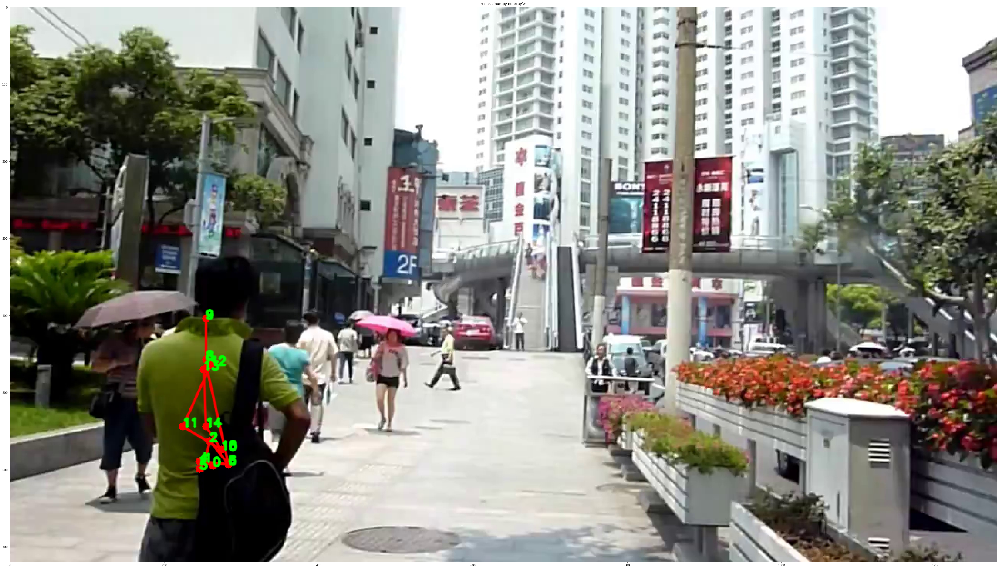

361


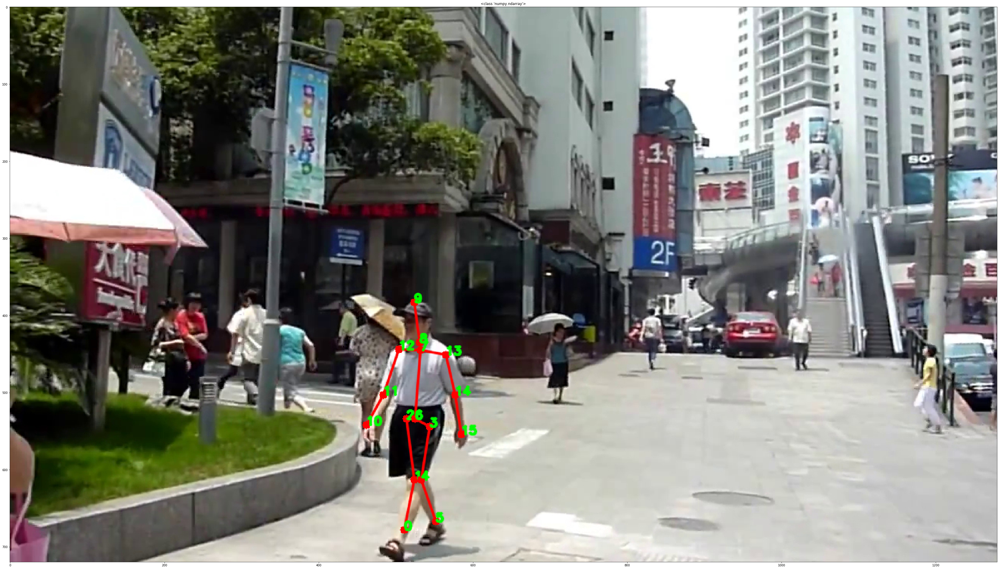

362


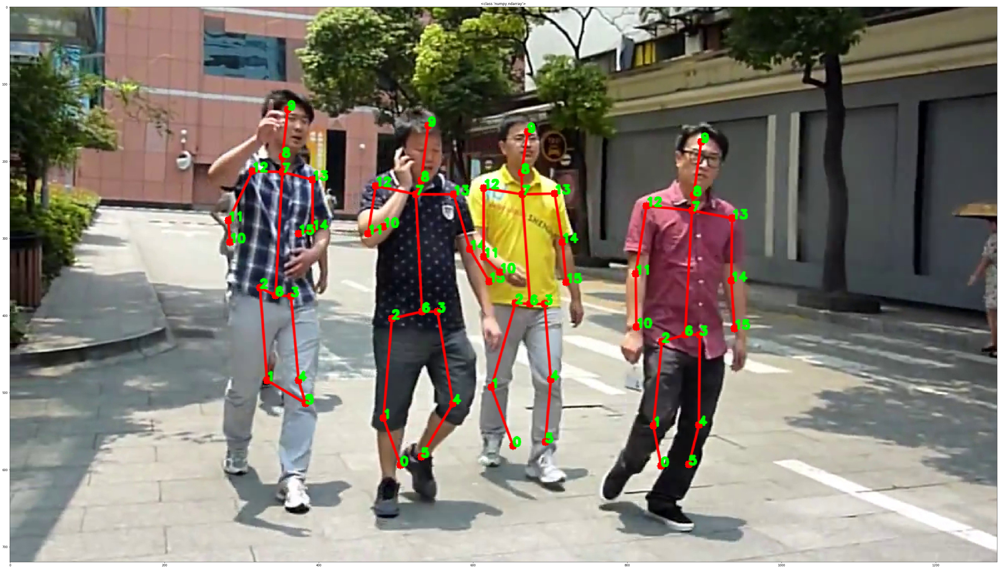

363


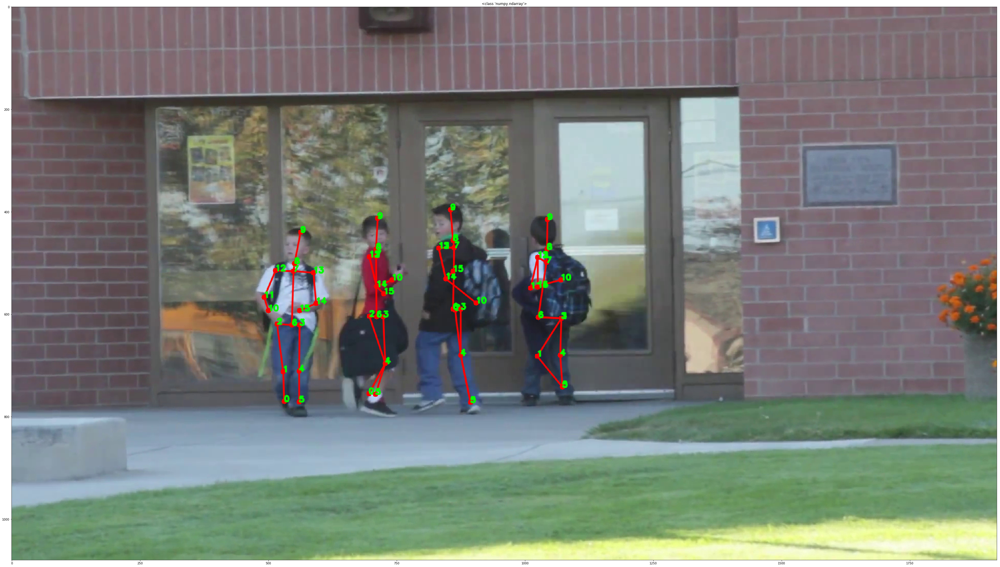

364


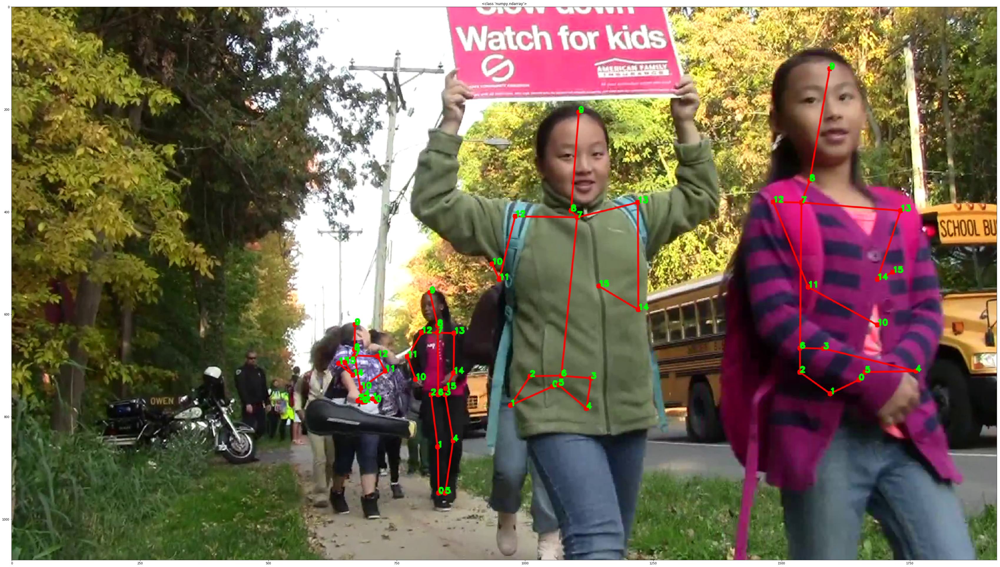

365


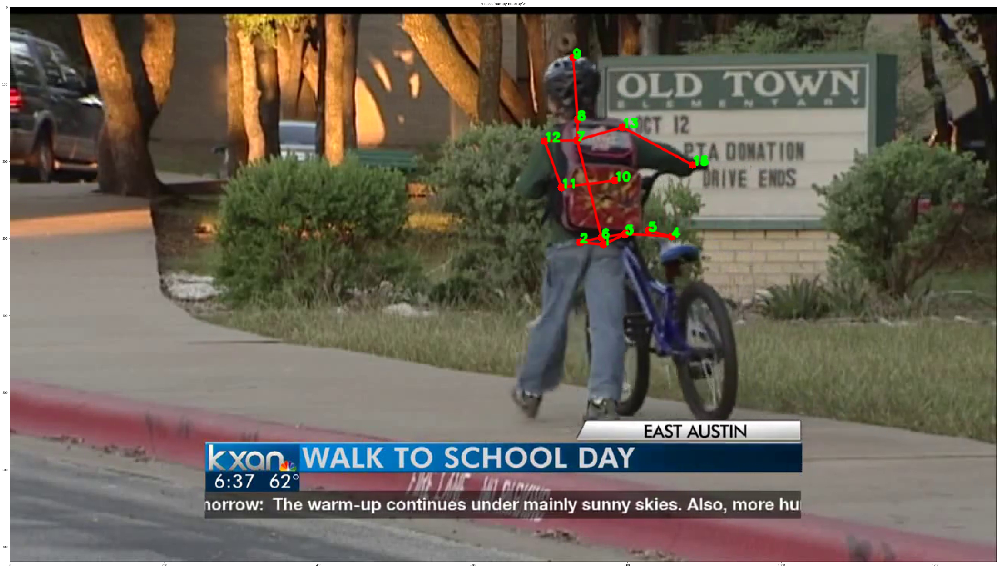

366


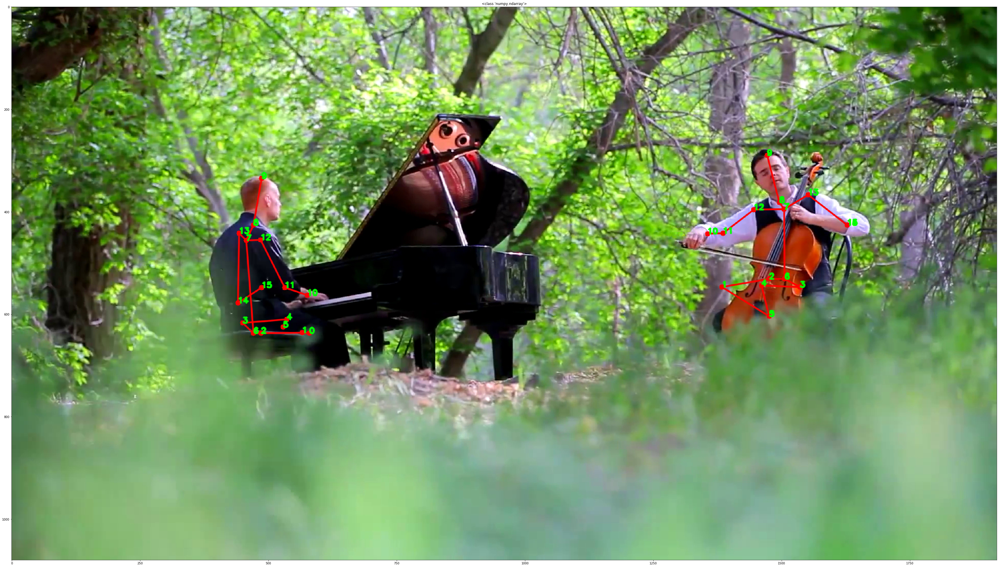

367


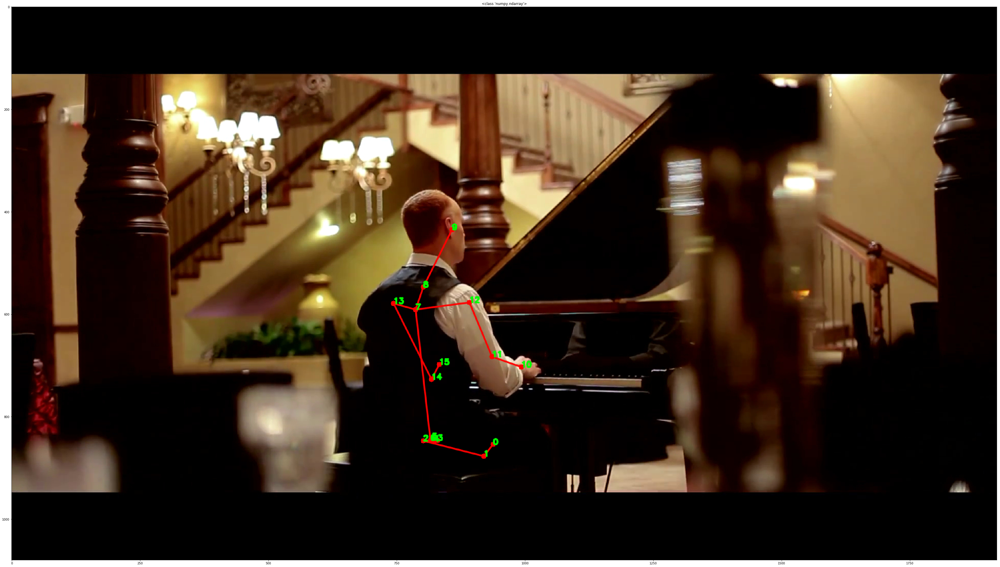

368


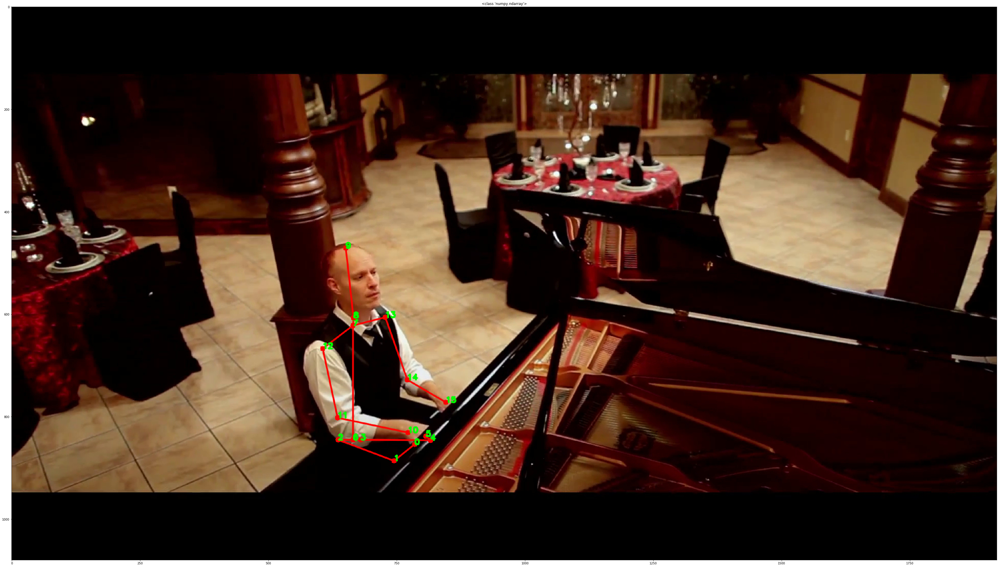

369


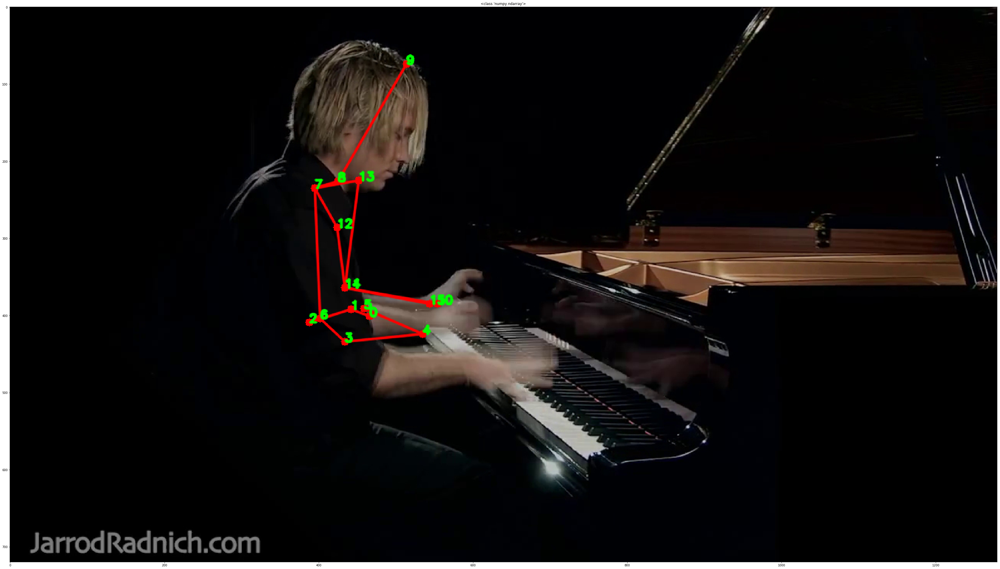

In [12]:
for i in range(360, 370):
    main(i)

